# 森林分野における衛星データ利用事例

## この章で学ぶこと

本章では、茨城県日立市を対象に、衛星データからNDVIを算出し、森林の状態変化を可視化する方法を学びます。

- `numpy`を用いた画像解析処理演算
- `rasterio` を用いたカラー合成画像の作成とマスク処理
- `rasterio` を用いたNDVIの計算
- `matplotlib` を用いたグラフ作成

Google Colabを利用している場合には、以下のコマンドを実行してください。

ライブラリのインストール後には**ランタイムの再起動**をしてください。

In [ ]:
!pip install pyproj
!pip install fiona
!pip install shapely
!pip install pygeos
!pip install geopandas
!pip install rasterio
!pip install sentinelsat
!pip install cartopy
!pip install rtree
!pip install sat-search
!pip install python-dateutil
!pip install pystac-client
# !pip install intake-stac
# !pip install git+https://github.com/intake/intake-stac

In [1]:
#必要ライブラリのインポート
import os
import numpy as np
import geopandas as gpd
import pandas as pd
import matplotlib
import cartopy, fiona, shapely, pyproj, rtree, pygeos
import cv2
matplotlib.rcParams['figure.dpi'] = 300 # 解像度
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import rasterio as rio
import rasterio.mask
import folium
import zipfile
import glob
import shutil
# from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt
# from PIL import Image
from IPython.display import Image
from mpl_toolkits.axes_grid1 import make_axes_locatable
from shapely.geometry import MultiPolygon, Polygon
from rasterio import plot
from rasterio.plot import show
from rasterio.plot import plotting_extent
from rasterio.mask import mask
from osgeo import gdal

import warnings
warnings.filterwarnings('ignore')

print("done")

done


この章では、地理空間情報を有した画像形式であるGeoTIFFを初めとしたラスター形式の画像ファイルを利用するためのライブラリである`rasterio`を中心にして解説をしていきます。

`osgeo.gdal`を利用する場合とコードに差はありますが、処理に必要な知識については変わるところはありません。rasterioは、gdalで出来るラスター画像の処理をほとんど代替できると考えて良いです。恐れずに言ってしまえば、rasterioはPython版のラスター解析用gdalということになります。加えて、そのコードはgdalに比べてすっきりとし、可読性も高くなります。

In [7]:
# Google Colabを使っている場合には、ドライブのマウントを行います
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### 日立市のポリゴン取得

続けて日立市のポリゴンデータ(shpファイル）を取得します。このファイルは、大きな衛星画像を日立市のみで切り取るために利用します。

国土地理院が公開している国土数値情報のうち[行政区域データ](https://nlftp.mlit.go.jp/ksj/gml/datalist/KsjTmplt-N03-v2_3.html)から[ダウンロード](https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_08_GML.zip)しましょう。ダウンロードは県単位になるため、茨城県から日立市のポリゴンを以下のように抜き出します（平成31年のデータを利用しています）。

抜き出したら、ポリゴンの座標系をSentinel-2のデータと同じUTM zone 54N (EPSG:32654) に変換します。座標系やEPSGについては、基礎分野の章や[空間情報クラブ](https://club.informatix.co.jp/?p=1225)のサイトを参照して下さい。


In [8]:
# 行政区域データをダウンロードするフォルダの作成
os.makedirs('ibrakiPolygon',exist_ok=True)

# wgetを行う
!wget --restrict-file-names=nocontrol \
     --content-disposition \
     --user-agent="Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:52.0) Gecko/20100101 Firefox/52.0" \
     "https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_08_GML.zip" \
     -P /content/ibrakiPolygon

import zipfile

# ダウンロードしたファイルを展開する
with zipfile.ZipFile('/content/ibrakiPolygon/N03-190101_08_GML.zip') as zipf:
  for zinfo in zipf.infolist():        # ZipInfoオブジェクトを取得
      if not zinfo.flag_bits & 0x800:  # flag_bitsプロパティで文字コードを取得
          # 文字コードが(cp437)だった場合はcp932へ変換する
          # strオブジェクトのプロパティencode/decodeでcp932に変換
          # 変換後のファイル名をfilenameプロパティで再度し直す
          zinfo.filename = zinfo.filename.encode('cp437').decode('cp932')
          if os.sep != "/" and os.sep in zinfo.filename:
            zinfo.filename = zinfo.filename.replace(os.sep, "/")

      zipf.extract(zinfo, '/content/ibrakiPolygon')

--2022-12-10 02:13:07--  https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_08_GML.zip
Resolving nlftp.mlit.go.jp (nlftp.mlit.go.jp)... 147.154.1.1, 147.154.45.210, 130.35.228.165
Connecting to nlftp.mlit.go.jp (nlftp.mlit.go.jp)|147.154.1.1|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3716112 (3.5M) [application/zip]
Saving to: ‘/content/ibrakiPolygon/N03-190101_08_GML.zip’

N03-190101_08_GML.z 100%[===================>]   3.54M  3.58MB/s    in 1.0s    

2022-12-10 02:13:09 (3.58 MB/s) - ‘/content/ibrakiPolygon/N03-190101_08_GML.zip’ saved [3716112/3716112]



done


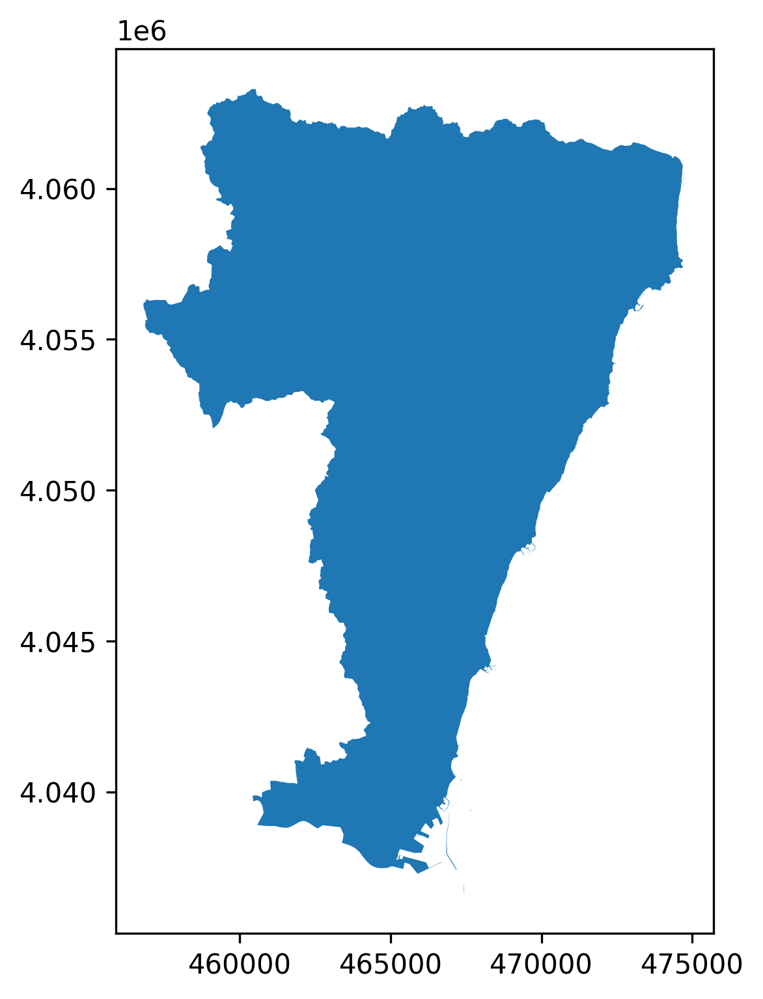

In [2]:
#ダウンロードしたデータを解凍して、ディレクトリを指定
shape_path = "/content/ibrakiPolygon/"

# 茨城県のshpの読み込み
in_shape = gpd.read_file(os.path.join(shape_path + "N03-19_08_190101.shp"),encoding="shift-jis")

# 日立市でソート
shape_srt = in_shape[in_shape["N03_004"].isin(["日立市"])]
shape_srt = shape_srt.drop(columns=["N03_002","N03_003"])

#画像に合わせて投影変換
out_file = os.path.join(shape_path + "re_N03-19_08_190101.shp")
re_shape = shape_srt.to_crs({"init": "epsg:32654"})

#出力
re_shape.to_file(driver="ESRI Shapefile",filename=out_file,encoding='utf-8')
print("done")

#GeoDataFrameを描画
f,ax = plt.subplots(1, figsize=(6,6))
ax = re_shape.plot(axes=ax)
plt.show();

In [ ]:
## ダウンロードしたデータがzipである場合には以下のコードを実行してください
## 基本的にはSAFEファイルから利用されると思いますが、状況に応じて使ってください

# # ファイルの解凍（zipfileを使う場合）
# a = glob.glob('/content/drive/MyDrive/s2/*.zip') #s2というフォルダにダウンロードファイルが入っています。

# ziplis = []
# for f in a:
#   print(f[26:86])
#   ziplis.append(f[26:86])

# for file_title in ziplis:
#   print("start unzip:"+ file_title)
#   file_name = file_title +".zip"
#   file_dir = "/content/drive/MyDrive/s2/"
#   file_pass = os.path.join(file_dir + file_name)
#   print(file_pass)
#   with zipfile.ZipFile(file_pass) as zf:
#     zf.extractall()
#   print("done")

- S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110.SAFE
- S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539.SAFE
- S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938.SAFE
- S2A_MSIL1C_20180420T011651_N0206_R031_T54SVF_20180420T030851.SAFE
- S2A_MSIL1C_20180520T011701_N0206_R031_T54SVF_20180520T030828.SAFE
- S2B_MSIL1C_20181002T011649_N0206_R031_T54SVF_20181002T030308.SAFE
- S2A_MSIL1C_20181219T013041_N0207_R074_T54SVF_20181219T031650.SAFE

が対象のファイルになります。

下のセルを実行する前に、該当のデータをダウンロードし、任意のフォルダに格納をしてください。

In [3]:
filePath = glob.glob("/content/drive/MyDrive/s2/*.SAFE") #  指定したディレクトリ内にある.SAFEのパスを取得
print(os.listdir(filePath[0])) # フォルダの中身をチェック

['MTD_MSIL1C.xml', 'INSPIRE.xml', 'manifest.safe', 'HTML', 'rep_info', 'GRANULE', 'AUX_DATA', 'DATASTRIP']


In [4]:
# バンドの数を調べます
print('The number of bands',+len(os.listdir('/content/drive/MyDrive/s2/S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110.SAFE/GRANULE/L1C_T54SVF_A009795_20170508T013110/IMG_DATA')))

The number of bands 14


上のようにダウンロードしたSAFEファイルに幾つかのフォルダがありますが、GRANULE以下が重要です。このファイル構造はオンラインかオフラインデータかによっても若干異なりますので、ダウンロードしたファイルがどのような階層構造にあるのかは確認すると良いです。

オンラインのデータであれば、画像データ (jp2)は分解能ごとに振り分けられているため、さらに複雑な構造になっています。しかし、画像データ自体は必ずGRANULE以下にあるので、必ずそこを調べるようにしてください。

まずは、RGB画像を作成するために、赤、緑、青のバンド情報を持った画像データのみを取得します。

In [5]:
# ファイル内のデータを探索するために、.SAFE以前の文字列を取得
ziplist = []

for f in filePath:
  print(f[26:86])
  ziplist.append(f[26:86])

S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110
S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539
S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938


In [6]:
#作業用ディレクトリ（フォルダ）の作成
os.makedirs('work', exist_ok=True)

path = '/content/'
work_path = '/content/work'

RGB_dir = '/content/work/RGB_TIF'
os.makedirs(RGB_dir, exist_ok=True)

NDVI_dir = '/content/work/NDVI'
os.makedirs(NDVI_dir, exist_ok=True)

NDVI_mask_dir = '/content/work/NDVI_mask'
os.makedirs(NDVI_mask_dir, exist_ok=True)

### カラー合成とマスク処理
Sentinel-2は異なる12の波長帯（バンド）で観測していると説明しましたが、ダウンロードしたデータはバンド毎にjpeg2の形式で格納されています。まずは、基礎分野で学習した「トゥルーカラー（True Color）」の組み合わせでカラー合成し、日立市以外の領域を除外します。

`rasterio`を用いて、バンド2（青）・バンド3（緑）・バンド4（赤）を組み合わせて合成画像を作成します。

In [8]:
# RGB画像を作成します。やや時間がかかります
parentPath = "/content/drive/MyDrive/s2/"
for file_title in ziplist:
  print("Start make RGB TIF image " +'<'+ file_title +'>')

  # jp2データの探索
  path_A = parentPath + str(file_title) + '.SAFE/GRANULE/'
  f1 = os.listdir(path_A)
  path_B = parentPath + str(file_title) + '.SAFE/GRANULE/' + str(f1[0])
  f2 = os.listdir(path_B)
  path_C = parentPath + str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) + '/IMG_DATA/'
  f3 = os.listdir(path_C)

  b2 = rio.open(parentPath + str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B02.jp2'))
  b3 = rio.open(parentPath + str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B03.jp2'))
  b4 = rio.open(parentPath +  str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B04.jp2'))
  # 出力ファイル名
  RGB_path = os.path.join(RGB_dir,'sentinel-2_'+str(f3[0][7:15])+'_RGB.tif')
  
  # GeoTIFFの作成
  RGB_colar = rio.open(RGB_path,'w',driver='Gtiff', #driverにGtiff(GeoTIFF)
                       width=b4.width, height=b4.height, #画像の高さや幅を指定。B04のバンドと同じ大きさにしています
                       count=3, #3つのバンドを利用 (B02, B03, B04)
                       crs=b4.crs, #crsもB04と同様。epsg:32654
                       transform=b4.transform, #データに対する変換も同様のもの
                       dtype=rio.uint16 #データ型を指定
                       )
  # 各々のバンド情報をRGB_colorに書き込み
  RGB_colar.write(b2.read(1),3) #青
  RGB_colar.write(b3.read(1),2) #緑
  RGB_colar.write(b4.read(1),1) #赤
  RGB_colar.close()

  print("---masking---")

  # 画像の切り取り処理
  with fiona.open(out_file, "r") as mask:
    masks = [feature["geometry"] for feature in mask] #ベクターデータが持つ図形情報の取得

  with rio.open(RGB_path) as src:
    out_image, out_transform = rio.mask.mask(src, masks, crop=True) #mask処理の実行
    out_meta = src.meta #作成する画像の情報はもともとの画像と同様のものにします

  # メタ情報の更新
  out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

  # 画像の書き出し
  with rio.open(RGB_path, "w", **out_meta) as dest:
    dest.write(out_image)
  
  # 画像表示のため8bit形式で書き出しを行います
  # scaleを調整することにより画像の見栄えが変化します
  scale = '-scale 0 255 0 15' # 元ファイルのピクセル値のmin, maxから変換後のピクセル値 min, maxとなります
  options_list = ['-ot Byte','-of Gtiff',scale]
  options_string = " ".join(options_list)

  gdal.Translate(os.path.join(RGB_dir + "/" + 'sentinel-2_'+str(f3[0][7:15])+'.tif'),os.path.join(RGB_dir + "/" + 'sentinel-2_'+str(f3[0][7:15])+'_RGB.tif'),options = options_string)

  print("Done")


Start make RGB TIF image <S2A_MSIL1C_20170508T012701_N0205_R074_T54SVF_20170508T013110>
---masking---
Done
Start make RGB TIF image <S2B_MSIL1C_20171027T011719_N0206_R031_T54SVF_20171027T030539>
---masking---
Done
Start make RGB TIF image <S2B_MSIL1C_20171226T012039_N0206_R031_T54SVF_20171226T024938>
---masking---
Done


作成した画像を描画しましょう。

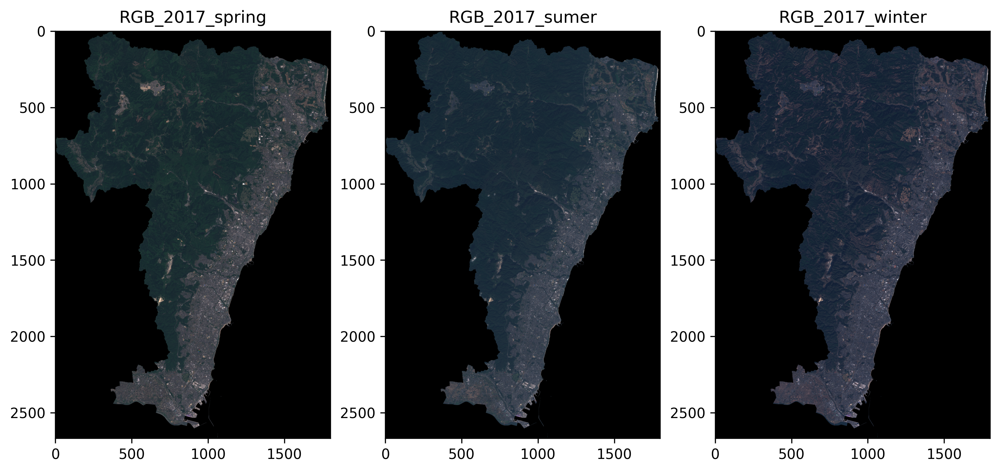

In [9]:
plt.figure(figsize=(12,8))

RGB_2017_spring = rio.open(RGB_dir+'/sentinel-2_20170508.tif')
RGB_2017_autumn = rio.open(RGB_dir+'/sentinel-2_20171027.tif')
RGB_2017_winter = rio.open(RGB_dir+'/sentinel-2_20171226.tif')

ax1 = plt.subplot(1,3,1)
ax1.set_title("RGB_2017_spring")
ax2 = plt.subplot(1,3,2)
ax2.set_title("RGB_2017_sumer")
ax3 = plt.subplot(1,3,3)
ax3.set_title("RGB_2017_winter")

show(RGB_2017_spring.read([1,2,3]),ax=ax1)
show(RGB_2017_autumn.read([1,2,3]),ax=ax2)
show(RGB_2017_winter.read([1,2,3]),ax=ax3)

2017年の3シーン（5月、10月、12月）のカラー合成画像です。見た目にはほとんど違いは分かりません。

### データの検索とダウンロード（API経由）

続いて、APIを利用してダウンロードする方法に紹介します。

オフラインのSentinel-2データを取得する方法は有料の方法を含めて幾つかありますが、今回はSTAC (Spatio Temporal Asset Cataloge)を利用する方法を紹介します。

先ずは、STACからデータをダウンロードしやすくするために必要なライブラリをインストールします。

In [10]:
# ライブラリのインポート
import os, json
from shapely.geometry import MultiPolygon, Polygon, box
from fiona.crs import from_epsg
import numpy as np
from satsearch import Search
from pystac_client import Client
from io import BytesIO
import urllib
from skimage import io
from PIL import Image
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import requests
import warnings
import re
import fiona
import rasterio as rio
from rasterio.mask import mask
from rasterio.plot import show
from osgeo import gdal
warnings.filterwarnings('ignore')

print("done")

done


日立市周辺の画像を取得するために、日立市の緯度経度を調べた上で、bboxと呼ばれる四角形に入れています。異なった場所を選ぶ場合には、「○○市、緯度　経度」のようにすると座標が知ることができます。

衛星画像はかなり広い範囲を撮影していますので、得られた座標に0.01度でも加えれば対象地が含まれる画像を取得できます。反対に大きなbboxを作ると、異なった撮影地点の画像データも取得結果に含める可能性が生じます。複数地点の画像を取得する意図がない限り、bboxの範囲は狭くても問題はありません。

In [11]:
# 取得範囲を指定するための関数を定義
def selSquare(minLon, minLat, maxLon, maxLat):
   c1 = [maxLon, maxLat]
   c2 = [maxLon, minLat]
   c3 = [minLon, minLat]
   c4 = [minLon, maxLat]
   geometry = {"type": "Polygon", "coordinates": [[ c1, c2, c3, c4, c1 ]]}
   return geometry

In [12]:
# 日立市周辺の緯度経度をbbox内へ
bbox = selSquare(140.47119140625, 36.34, 140.60, 36.43) # (min lon, min lat, max lon, max lat)
dates = '2017-01-01/2017-12-31'

api_url = 'https://earth-search.aws.element84.com/v0'
collection = "sentinel-s2-l2a-cogs"  # Sentinel-2, Level 2A (BOA)
s2STAC = Client.open(api_url, headers=[])
s2STAC.add_conforms_to("ITEM_SEARCH")


s2Search = s2STAC.search (
   intersects = bbox,
   datetime = dates,
   query = {"eo:cloud_cover": {"lt": 10}, "sentinel:valid_cloud_cover": {"eq": True}},
   collections = collection)

s2_items = [i.to_dict() for i in s2Search.get_items()]
print(f"{len(s2_items)} のシーンを取得")

28 のシーンを取得


検索の結果28件の画像データが取得できたことがわかります。ここから、さらに結果を絞ります。

In [13]:
items = s2Search.get_all_items()
df = gpd.GeoDataFrame.from_features(items.to_dict(), crs="epsg:4326")
# 雲量で並び替え
dfSorted = df.sort_values('eo:cloud_cover').reset_index(drop=True)
dfSorted.head()

,geometry,created,sentinel:product_id,sentinel:sequence,view:off_nadir,sentinel:valid_cloud_cover,platform,sentinel:utm_zone,proj:epsg,sentinel:grid_square,datetime,instruments,constellation,eo:cloud_cover,gsd,sentinel:latitude_band,data_coverage,updated,sentinel:data_coverage
0,"POLYGON ((139.88933 36.05159, 139.87508 37.041...",2020-10-01T23:15:37.687Z,S2A_MSIL2A_20170508T012701_N0001_R074_T54SVF_2...,0,0,True,sentinel-2a,54,32654,VF,2017-05-08T01:31:10Z,[msi],sentinel-2,0.0,10,S,NaN,2020-10-01T23:15:37.687Z,100.00
1,"POLYGON ((140.31252 36.05476, 140.59339 37.045...",2020-09-28T09:44:27.210Z,S2B_MSIL2A_20171226T012039_N0001_R031_T54SVF_2...,0,0,True,sentinel-2b,54,32654,VF,2017-12-26T01:20:37Z,[msi],sentinel-2,0.0,10,S,53.5,2020-09-28T09:44:27.210Z,53.50
2,"POLYGON ((140.32434 36.05483, 140.60522 37.045...",2020-09-01T14:48:23.018Z,S2B_MSIL2A_20171027T011719_N0001_R031_T54SVF_2...,0,0,True,sentinel-2b,54,32654,VF,2017-10-27T01:17:21Z,[msi],sentinel-2,0.0,10,S,NaN,2020-09-01T14:48:23.018Z,52.58
3,"POLYGON ((139.88933 36.05159, 139.87508 37.041...",2020-09-18T07:58:45.993Z,S2A_MSIL2A_20171214T013041_N0001_R074_T54SVF_2...,0,0,True,sentinel-2a,54,32654,VF,2017-12-14T01:36:04Z,[msi],sentinel-2,0.0,10,S,100.0,2020-09-18T07:58:45.993Z,100.00
4,"POLYGON ((140.13762 36.05363, 140.01214 36.081...",2020-09-01T14:54:18.487Z,S2B_MSIL2A_20171209T013029_N0001_R074_T54SVF_2...,1,0,True,sentinel-2b,54,32654,VF,2017-12-09T01:30:43Z,[msi],sentinel-2,0.0,10,S,NaN,2020-09-01T14:54:18.487Z,99.36


`eo:cloud_cover`とあるところが、雲の量についてのデータとなります。

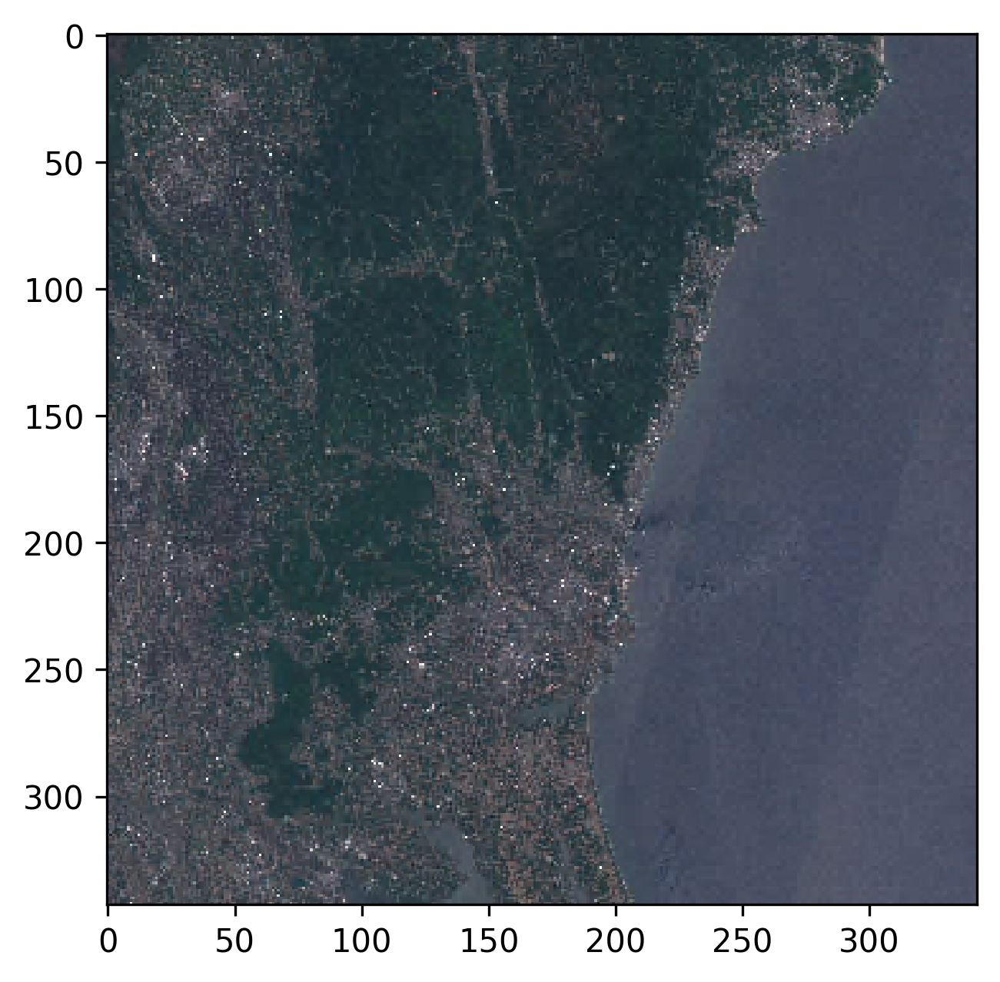

In [14]:
# 最も雲の量が少ないシーンを選択し、サムネイル画像も取得する関数を定義します。
def sel_items(scene_items, product_id):
 item = [x.assets for x in scene_items\
         if x.properties['sentinel:product_id'] == product_id]
 thumbUrl = [x.assets['thumbnail'].href for x in scene_items\
             if x.properties['sentinel:product_id'] == product_id]
 return item, thumbUrl

selected_item, thumbUrl = sel_items(items, dfSorted['sentinel:product_id'][0])

thumbImg = Image.open(BytesIO(requests.get(thumbUrl[0]).content))
plt.figure(figsize=(5,5))
plt.imshow(thumbImg)

バンドごとの画像データを取得し、RGB画像の作成からポリゴンデータによる切り取りまでを行なってみましょう。

In [15]:
# 引用：https://note.nkmk.me/python-download-web-images/
def download_file(url, dst_path):
   try:
       with urllib.request.urlopen(url) as web_file, open(dst_path, 'wb') as local_file:
           local_file.write(web_file.read())
   except urllib.error.URLError as e:
       print(e)

def download_file_to_dir(url, dst_dir):
   download_file(url, os.path.join(dst_dir, os.path.basename(url)))

# 取得するバンドの選択
bandLists = ['B04','B03','B02'] # RED, GREEN, BLUE

# 画像のURL取得
file_url = []
[file_url.append(selected_item[0][band].href) for band in bandLists if file_url.append(selected_item[0][band].href) is not None]

# 画像のダウンロード
[download_file_to_dir(link, RGB_dir) for link in file_url if download_file_to_dir(link, RGB_dir) is not None]

[]

In [16]:
# 参照：https://automating-gis-processes.github.io/CSC18/lessons/L6/clipping-raster.html
# bboxの値はそのままで利用できないため、以下のコードを用いて変換を行います

bbox = box(140.47119140625, 36.34, 140.60, 36.43)
geo = gpd.GeoDataFrame({'geometry': bbox}, index=[0], crs=from_epsg(4326)) # WGS84座標系を指定
geo = geo.to_crs(crs='epsg:32654') # Sentinel-2の画像に合わせます

def getFeatures(gdf):
    """rasterioで読み取れる形のデータに変換するための関数です"""
    return [json.loads(gdf.to_json())['features'][0]['geometry']]

coords = getFeatures(geo)
print(coords)

[{'type': 'Polygon', 'coordinates': [[[464104.2464389408, 4021734.745906897], [464145.59058161866, 4031717.777685681], [452599.6147810663, 4031773.3532265895], [452544.95596871467, 4021790.267053706], [464104.2464389408, 4021734.745906897]]]}]


In [17]:
# 画像の読み込み
b2 = rio.open(file_url[2])
b3 = rio.open(file_url[1])
b4 = rio.open(file_url[0])

# 出力ファイル名
RGB_path = os.path.join(RGB_dir,'sentinel-2_l2a-cogs'+'_Masked.tif')
  
# GeoTIFFの作成
RGB_colar = rio.open(RGB_path,'w',driver='Gtiff', #driverにGtiff(GeoTIFF)
    width=b4.width, height=b4.height, #画像の高さや幅を指定。B04のバンドと同じ大きさにしています
    count=3, #3つのバンドを利用 (B02, B03, B04)
    crs=b4.crs, #crsもB04と同様。epsg:32654
    transform=b4.transform, #データに対する変換も同様のもの
    dtype=rio.uint16 #データ型を指定
    )
# 各々のバンド情報をRGB_colorに書き込み
RGB_colar.write(b2.read(1),3) #青
RGB_colar.write(b3.read(1),2) #緑
RGB_colar.write(b4.read(1),1) #赤
RGB_colar.close()

# 画像の切り取り処理
with fiona.open(out_file, "r") as mask:
  masks = [feature["geometry"] for feature in mask] #ベクターデータが持つ図形情報の取得

with rio.open(RGB_path) as src:
  out_image, out_transform = rio.mask.mask(src, masks, crop=True) #mask処理の実行
  out_meta = src.meta #作成する画像の情報はもともとの画像と同様のものにします

# メタ情報の更新
out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

# 画像の書き出し
with rio.open(RGB_path, "w", **out_meta) as dest:
  dest.write(out_image)

#画像表示のため8bit形式で書き出し。
scale = '-scale 0 255 0 25'
options_list = ['-ot Byte','-of Gtiff',scale]
options_string = " ".join(options_list)

gdal.Translate(os.path.join(RGB_dir,'sentinel-2_l2a-cogs'+'.tif'),os.path.join(RGB_dir,'sentinel-2_l2a-cogs_Masked'+'.tif'),options = options_string)

print("done")

done


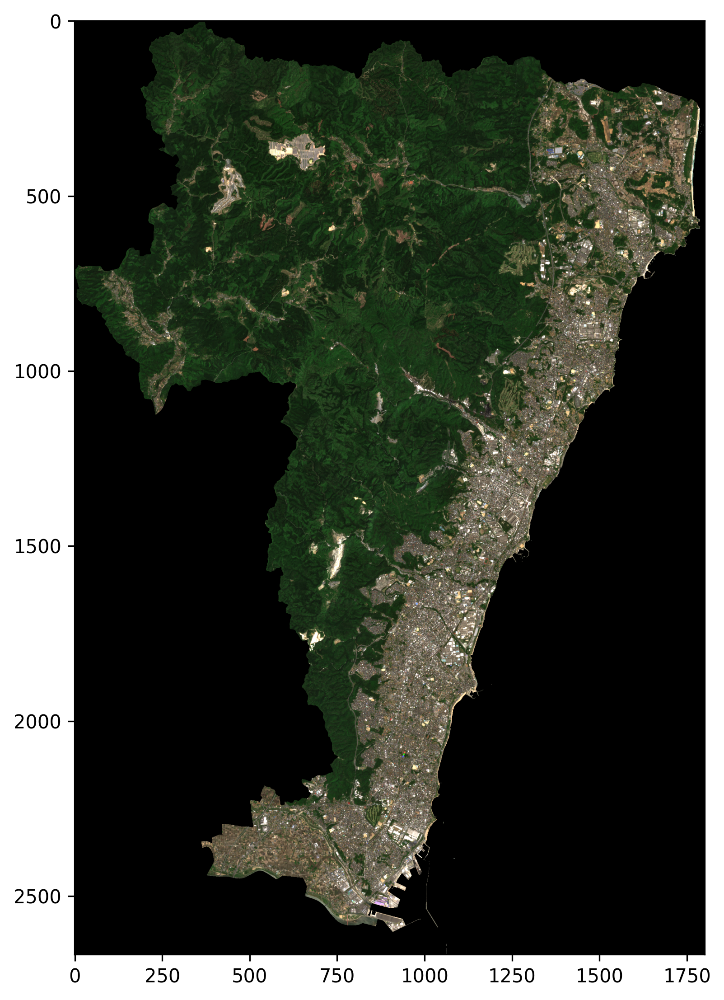

In [21]:
plt.figure(figsize=(6,10))
RGB_2017OctCOG = rio.open('/content/work/RGB_TIF/sentinel-2_l2a-cogs.tif')
show(RGB_2017OctCOG.read([1,2,3]))

同じ画像が描画できました。

この方法を用いることにより、オフラインプロダクトの不便さを解消することができます。画像処理という面においても、こちらの方がより高速で処理を行うことが可能です。

2017年から2018年の春から冬にかけてのデータを改めて取得します。

In [22]:
# 日立市周辺の緯度経度をbbox内へ
bbox = selSquare(140.47, 36.34, 140.60, 36.43) # (min lon, min lat, max lon, max lat)
dates = '2017-01-01/2018-12-31'

api_url = 'https://earth-search.aws.element84.com/v0'
collection = "sentinel-s2-l2a-cogs"  # Sentinel-2, Level 2A (BOA)
s2STAC = Client.open(api_url, headers=[])
s2STAC.add_conforms_to("ITEM_SEARCH")

s2Search = s2STAC.search (
   intersects = bbox,
   datetime = dates,
  #  query = {"eo:cloud_cover": {"lt": 10}, "sentinel:valid_cloud_cover": {"eq": True}},
   collections = collection)

s2_items = [i.to_dict() for i in s2Search.get_items()]
print(f"{len(s2_items)} のシーンを取得")

items = s2Search.get_all_items()
df = gpd.GeoDataFrame.from_features(items.to_dict(), crs="epsg:4326")
# 雲量で並び替え
s2Gdf = df.sort_values('eo:cloud_cover').reset_index(drop=True)
s2Gdf.head()

154 のシーンを取得


,geometry,created,sentinel:product_id,sentinel:sequence,view:off_nadir,sentinel:valid_cloud_cover,platform,sentinel:utm_zone,proj:epsg,sentinel:grid_square,datetime,instruments,constellation,eo:cloud_cover,gsd,sentinel:latitude_band,data_coverage,updated,sentinel:data_coverage
0,"POLYGON ((140.30443 36.05472, 140.58542 37.045...",2020-09-08T11:52:35.068Z,S2A_MSIL2A_20180420T011651_N0001_R031_T54SVF_2...,0,0,True,sentinel-2a,54,32654,VF,2018-04-20T01:16:54Z,[msi],sentinel-2,0.0,10,S,54.20,2020-09-08T11:52:35.068Z,54.20
1,"POLYGON ((140.31252 36.05476, 140.59339 37.045...",2020-09-28T09:44:27.210Z,S2B_MSIL2A_20171226T012039_N0001_R031_T54SVF_2...,0,0,True,sentinel-2b,54,32654,VF,2017-12-26T01:20:37Z,[msi],sentinel-2,0.0,10,S,53.50,2020-09-28T09:44:27.210Z,53.50
2,"POLYGON ((140.32669 36.05484, 140.60743 37.045...",2020-09-18T07:38:43.580Z,S2B_MSIL2A_20171106T011819_N0001_R031_T54SVF_2...,0,0,True,sentinel-2b,54,32654,VF,2017-11-06T01:23:03Z,[msi],sentinel-2,0.0,10,S,52.40,2020-09-18T07:38:43.580Z,52.40
3,"POLYGON ((140.32434 36.05483, 140.60522 37.045...",2020-09-01T14:48:23.018Z,S2B_MSIL2A_20171027T011719_N0001_R031_T54SVF_2...,0,0,True,sentinel-2b,54,32654,VF,2017-10-27T01:17:21Z,[msi],sentinel-2,0.0,10,S,NaN,2020-09-01T14:48:23.018Z,52.58
4,"POLYGON ((140.30863 36.05474, 140.58882 37.045...",2020-09-08T11:34:27.205Z,S2A_MSIL2A_20180110T012021_N0001_R031_T54SVF_2...,0,0,True,sentinel-2a,54,32654,VF,2018-01-10T01:23:45Z,[msi],sentinel-2,0.0,10,S,53.89,2020-09-08T11:34:27.205Z,53.89


In [23]:
s2Gdf.datetime = pd.to_datetime(s2Gdf.datetime, format='%Y-%m-%d')
s2Gdf['month'] = s2Gdf.datetime.dt.month
s2Gdf['year'] = s2Gdf.datetime.dt.year

In [24]:
# 指定した年と月で最も雲の量が少ない値を返す
def getMinCloudItem(df,year,month):
  df = df.loc[(df.year == year) & (df.month == month),:].reset_index(drop=True).copy()
  df = df.sort_values('eo:cloud_cover').reset_index(drop=True)
  df = df['sentinel:product_id']
  minId = list(df)
  
  return minId[0]

In [25]:
# 2017年から2018年の1月から12月までで、雲量が最小のものを選択
listIds = []
for y in range(2017,2019):
  for m in range(1,13):
    listIds.append(getMinCloudItem(s2Gdf,y,m)) #ID取得

print(listIds)

['S2A_MSIL2A_20170118T013001_N0001_R074_T54SVF_20200718T010232', 'S2A_MSIL2A_20170204T011831_N0001_R031_T54SVF_20200718T145944', 'S2A_MSIL2A_20170316T011641_N0001_R031_T54SVF_20200719T081731', 'S2A_MSIL2A_20170405T011651_N0001_R031_T54SVF_20200719T122852', 'S2A_MSIL2A_20170508T012701_N0001_R074_T54SVF_20200720T181732', 'S2A_MSIL2A_20170604T011651_N0001_R031_T54SVF_20200719T190248', 'S2B_MSIL2A_20170709T011649_N0001_R031_T54SVF_20200402T030115', 'S2A_MSIL2A_20170823T011651_N0001_R031_T54SVF_20200401T101414', 'S2A_MSIL2A_20170925T012651_N0001_R074_T54SVF_20200401T072940', 'S2B_MSIL2A_20171027T011719_N0001_R031_T54SVF_20200327T232429', 'S2B_MSIL2A_20171106T011819_N0001_R031_T54SVF_20200330T183638', 'S2B_MSIL2A_20171226T012039_N0001_R031_T54SVF_20200330T053729', 'S2A_MSIL2A_20180110T012021_N0001_R031_T54SVF_20200325T190603', 'S2A_MSIL2A_20180209T011811_N0001_R031_T54SVF_20200326T181258', 'S2A_MSIL2A_20180304T012651_N0001_R074_T54SVF_20200315T105901', 'S2A_MSIL2A_20180420T011651_N0001_R031_

In [26]:
allthumbUrl = []
for id in listIds:
  for item in items:
    if item.properties['sentinel:product_id'] == id:
      allthumbUrl.append(item.assets['thumbnail'].href)
      break

len(allthumbUrl)

24

In [27]:
def getPreview(thumbList, r_num, c_num, figsize_x=12, figsize_y=12):
  """
  サムネイル画像を指定した引数に応じて行列状に表示
  r_num: 行数
  c_num: 列数
  """
  thumbs = thumbList
  f, ax_list = plt.subplots(r_num, c_num, figsize=(figsize_x,figsize_y))
  for row_num, ax_row in enumerate(ax_list):
    for col_num, ax in enumerate(ax_row):
      if len(thumbs) < r_num*c_num:
        len_shortage = r_num*c_num - len(thumbs) # 行列の不足分を算出
        count = row_num * c_num + col_num
        if count < len(thumbs):
          ax.label_outer() # サブプロットのタイトルと、軸のラベルが被らないようにします
          ax.imshow(io.imread(thumbs[row_num * c_num + col_num]))
          ax.set_title(thumbs[row_num * c_num + col_num][60:79])
        else:
          for i in range(len_shortage):
            blank = np.zeros([100,100,3],dtype=np.uint8)
            blank.fill(255)
            ax.label_outer()
            ax.imshow(blank)
      else:
        ax.label_outer()
        ax.imshow(io.imread(thumbs[row_num * c_num + col_num]))
        ax.set_title(thumbs[row_num * c_num + col_num][60:79])
  return plt.show()

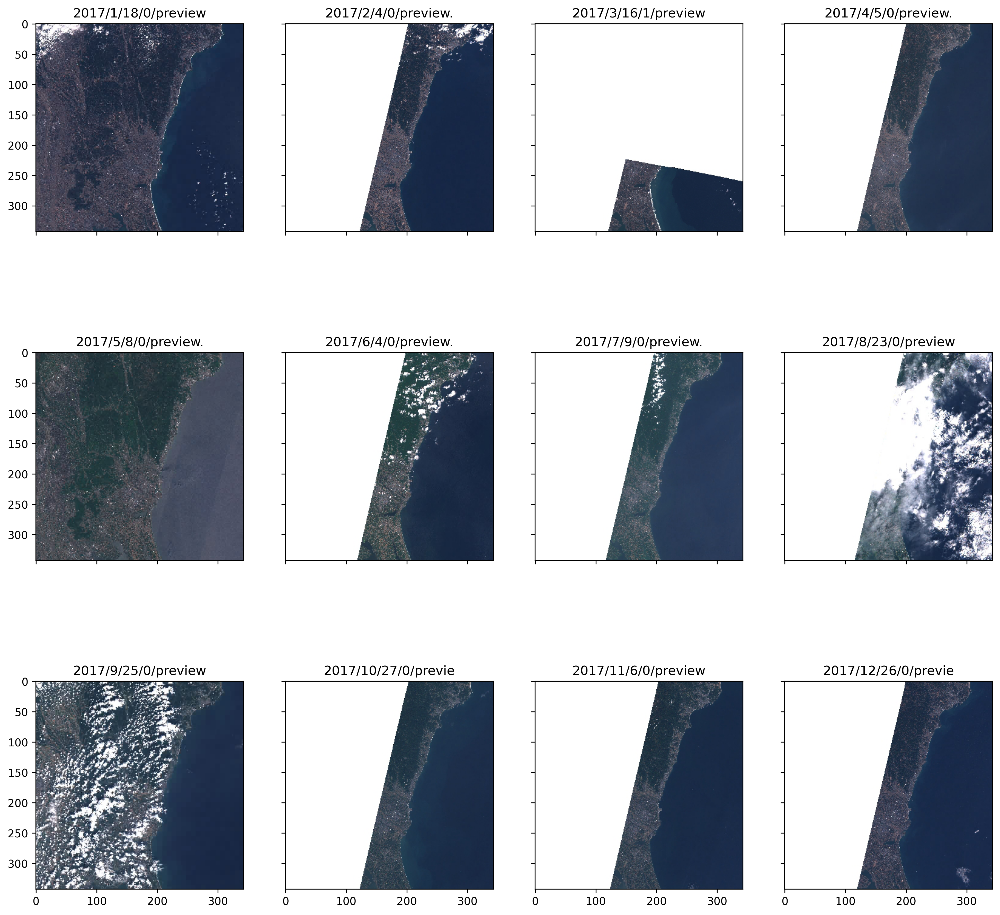

In [28]:
# 2017年のサムネイル画像を描画
getPreview(allthumbUrl[0:13],3,4,16,16)

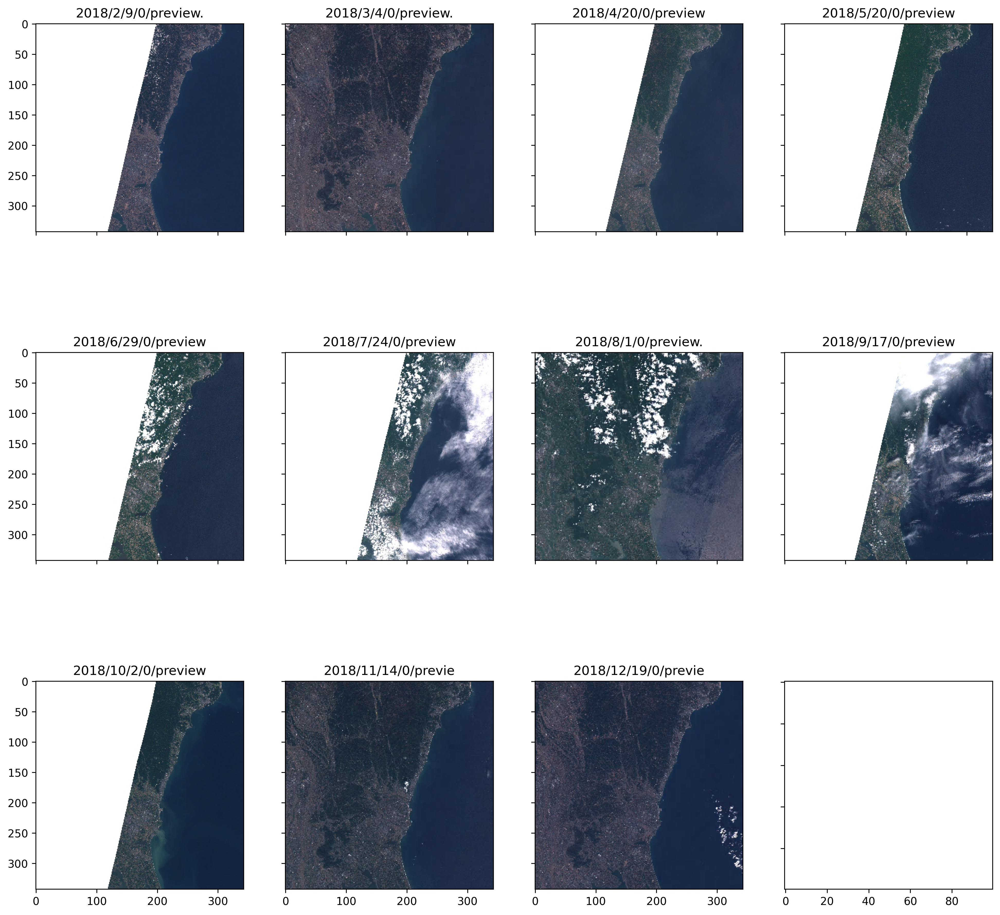

In [29]:
# 2018年のサムネイル画像を描画
getPreview(allthumbUrl[13:24],3,4,16,16)

このようにサムネイル画像を目視することで、期待通りに雲が少ない画像が取得できているのかを確認することができます。

In [30]:
selIds = [listIds[i] for i in [3,4,9,11,15,16,21,23]]
# 該当のitemのみを抽出
selectItems = []
for id in selIds:
  for item in items:
    if item.properties['sentinel:product_id'] == id:
      selectItems.append(item)
      break

print(len(selectItems))

8


続けて画像データを任意のフォルダに保存しましょう。

In [31]:
# 引用：https://note.nkmk.me/python-download-web-images/
def download_file(url, dst_path):
  filename = re.sub(r'(.*)(?=S2[AB])','',url).split('/')
  filename = filename[0]+filename[1]
  print(filename)
  try:
    with urllib.request.urlopen(url) as web_file, open(os.path.join(dst_path,filename), 'wb') as local_file:
      local_file.write(web_file.read())
  except urllib.error.URLError as e:
    print(e)

def download_file_to_dir(url, dst_dir):
   download_file(url, dst_dir)

sentinel2_compositeのフォルダに該当の画像データを全て保存します。

In [32]:
# 取得するバンドの選択
bandLists = ['B04','B03','B02'] # RED, GREEN, BLUE

# 画像のURL取得
file_url = []
for item in selectItems:
  for band in bandLists:
    if file_url.append(item.assets[band].href) is not None:
      file_url.append(selectItems[0][band].href)

# 画像のダウンロード
[download_file_to_dir(link, RGB_dir) for link in file_url if download_file_to_dir(link, RGB_dir) is not None]

S2A_54SVF_20170405_0_L2AB04.tif
S2A_54SVF_20170405_0_L2AB03.tif
S2A_54SVF_20170405_0_L2AB02.tif
S2A_54SVF_20170508_0_L2AB04.tif
S2A_54SVF_20170508_0_L2AB03.tif
S2A_54SVF_20170508_0_L2AB02.tif
S2B_54SVF_20171027_0_L2AB04.tif
S2B_54SVF_20171027_0_L2AB03.tif
S2B_54SVF_20171027_0_L2AB02.tif
S2B_54SVF_20171226_0_L2AB04.tif
S2B_54SVF_20171226_0_L2AB03.tif
S2B_54SVF_20171226_0_L2AB02.tif
S2A_54SVF_20180420_0_L2AB04.tif
S2A_54SVF_20180420_0_L2AB03.tif
S2A_54SVF_20180420_0_L2AB02.tif
S2A_54SVF_20180520_0_L2AB04.tif
S2A_54SVF_20180520_0_L2AB03.tif
S2A_54SVF_20180520_0_L2AB02.tif
S2B_54SVF_20181002_0_L2AB04.tif
S2B_54SVF_20181002_0_L2AB03.tif
S2B_54SVF_20181002_0_L2AB02.tif
S2A_54SVF_20181219_0_L2AB04.tif
S2A_54SVF_20181219_0_L2AB03.tif
S2A_54SVF_20181219_0_L2AB02.tif


[]

In [33]:
# ユニークなIDを作成
from collections import OrderedDict
def extractIds(nameLists):
    nameList = []
    for url in nameLists:
      filename = re.sub(r'(.*)(?=S2[AB])','',url).split('/')
      nameList.append(filename[0])

    nameList = OrderedDict(zip(nameList,['']*len(nameList))).keys()

    return list(nameList)

setIds = extractIds(file_url)
setIds

['S2A_54SVF_20170405_0_L2A',
 'S2A_54SVF_20170508_0_L2A',
 'S2B_54SVF_20171027_0_L2A',
 'S2B_54SVF_20171226_0_L2A',
 'S2A_54SVF_20180420_0_L2A',
 'S2A_54SVF_20180520_0_L2A',
 'S2B_54SVF_20181002_0_L2A',
 'S2A_54SVF_20181219_0_L2A']

※ `mode string must be one of 'r', 'w', or 'a', not wb open`のようなエラーが出てファイルをダウンロードできない場合には、colabのランタイムを再起動することで解決することがあります。

In [34]:
# RGB画像を作成します。やや時間がかかります
for index, Id in enumerate(setIds):
  print("Start make RGB TIF image " +'<'+ Id +'>')

  b4 = rio.open(file_url[index*3])
  b3 = rio.open(file_url[index*3+1])
  b2 = rio.open(file_url[index*3+2])
  # 出力ファイル名
  RGB_path = os.path.join(RGB_dir,'COGsentinel-2_'+Id+'_Masked.tif')
  print(RGB_path)
  print(file_url[index*3])
  print(file_url[index*3+1])
  print(file_url[index*3+2])
  # GeoTIFFの作成
  RGB_colar = rio.open(RGB_path,'w',driver='Gtiff', #driverにGtiff(GeoTIFF)
                       width=b4.width, height=b4.height, #画像の高さや幅を指定。B04のバンドと同じ大きさにしています
                       count=3, #3つのバンドを利用 (B02, B03, B04)
                       crs=b4.crs, #crsもB04と同様。epsg:32654
                       transform=b4.transform, #データに対する変換も同様のもの
                       dtype=rio.uint16 #データ型を指定
                       )
  # 各々のバンド情報をRGB_colorに書き込み
  RGB_colar.write(b2.read(1),3) #青
  RGB_colar.write(b3.read(1),2) #緑
  RGB_colar.write(b4.read(1),1) #赤
  RGB_colar.close()

  print("---masking---")

  # 画像の切り取り処理
  with fiona.open(out_file, "r") as mask:
    masks = [feature["geometry"] for feature in mask] #ベクターデータが持つ図形情報の取得

  with rio.open(RGB_path) as src:
    out_image, out_transform = rio.mask.mask(src, masks, crop=True) #mask処理の実行
    out_meta = src.meta #作成する画像の情報はもともとの画像と同様のものにします

  # メタ情報の更新
  out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

  # 画像の書き出し
  with rio.open(RGB_path, "w", **out_meta) as dest:
    dest.write(out_image)
  
  # 画像表示のため8bit形式で書き出しを行います
  # scaleを調整することにより画像の見栄えが変化します
  scale = '-scale 0 255 0 25' # 元ファイルのピクセル値のmin, maxから変換後のピクセル値 min, maxとなります
  options_list = ['-ot Byte','-of Gtiff',scale]
  options_string = " ".join(options_list)

  gdal.Translate(os.path.join(RGB_dir + "/" + 'COGsentinel-2_'+ Id +'.tif'),os.path.join(RGB_dir + "/" + 'COGsentinel-2_'+Id+'_Masked.tif'),options = options_string)

  print("Done")


Start make RGB TIF image <S2A_54SVF_20170405_0_L2A>
/content/work/RGB_TIF/COGsentinel-2_S2A_54SVF_20170405_0_L2A_Masked.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B03.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B02.tif
---masking---
Done
Start make RGB TIF image <S2A_54SVF_20170508_0_L2A>
/content/work/RGB_TIF/COGsentinel-2_S2A_54SVF_20170508_0_L2A_Masked.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B03.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B02.tif
---masking---
Done
Start 

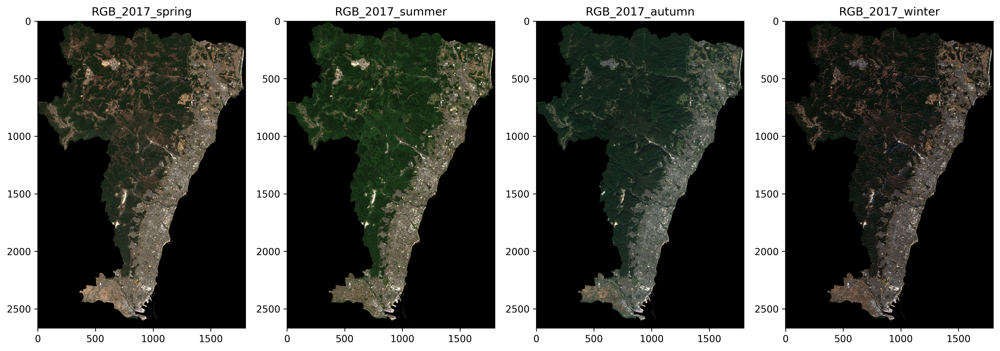

In [35]:
# 2017年
plt.figure(figsize=(18,9))

RGB_2017_spring = rio.open(RGB_dir+'/COGsentinel-2_S2A_54SVF_20170405_0_L2A.tif')
RGB_2017_summer = rio.open(RGB_dir+'/COGsentinel-2_S2A_54SVF_20170508_0_L2A.tif')
RGB_2017_autumn = rio.open(RGB_dir+'/COGsentinel-2_S2B_54SVF_20171027_0_L2A.tif')
RGB_2017_winter = rio.open(RGB_dir+'/COGsentinel-2_S2B_54SVF_20171226_0_L2A.tif')

ax1 = plt.subplot(1,4,1)
ax1.set_title("RGB_2017_spring")
ax2 = plt.subplot(1,4,2)
ax2.set_title("RGB_2017_summer")
ax3 = plt.subplot(1,4,3)
ax3.set_title("RGB_2017_autumn")
ax4 = plt.subplot(1,4,4)
ax4.set_title("RGB_2017_winter")

show(RGB_2017_spring.read([1,2,3]),ax=ax1)
show(RGB_2017_summer.read([1,2,3]),ax=ax2)
show(RGB_2017_autumn.read([1,2,3]),ax=ax3)
show(RGB_2017_winter.read([1,2,3]),ax=ax4)

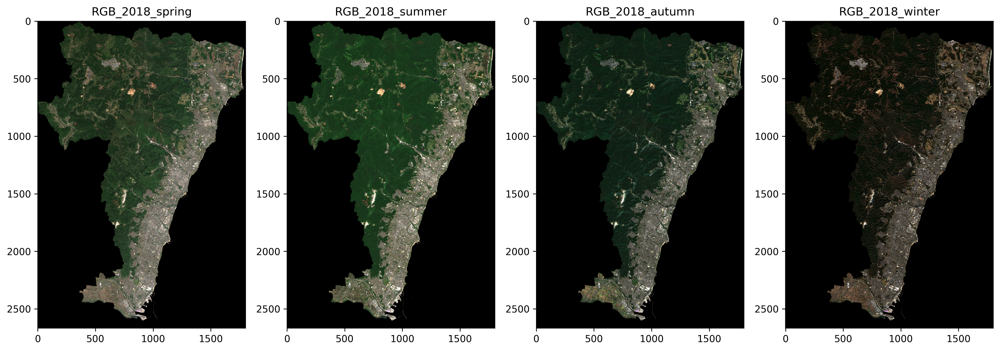

In [36]:
# 2018年
plt.figure(figsize=(18,9))

RGB_2018_spring = rio.open(RGB_dir+'/COGsentinel-2_S2A_54SVF_20180420_0_L2A.tif')
RGB_2018_summer = rio.open(RGB_dir+'/COGsentinel-2_S2A_54SVF_20180520_0_L2A.tif')
RGB_2018_autumn = rio.open(RGB_dir+'/COGsentinel-2_S2B_54SVF_20181002_0_L2A.tif')
RGB_2018_winter = rio.open(RGB_dir+'/COGsentinel-2_S2A_54SVF_20181219_0_L2A.tif')

ax1 = plt.subplot(1,4,1)
ax1.set_title("RGB_2018_spring")
ax2 = plt.subplot(1,4,2)
ax2.set_title("RGB_2018_summer")
ax3 = plt.subplot(1,4,3)
ax3.set_title("RGB_2018_autumn")
ax4 = plt.subplot(1,4,4)
ax4.set_title("RGB_2018_winter")

show(RGB_2018_spring.read([1,2,3]),ax=ax1)
show(RGB_2018_summer.read([1,2,3]),ax=ax2)
show(RGB_2018_autumn.read([1,2,3]),ax=ax3)
show(RGB_2018_winter.read([1,2,3]),ax=ax4)

## 森林の状態変化の可視化

### 森林地域のポリゴン取得

国土地理院の国土数値情報には、土地利用基本計画に基づき指定された[森林地域のポリゴン](https://nlftp.mlit.go.jp/ksj/gml/datalist/KsjTmplt-A13.html)も含まれています。このサイトから茨城県の森林地域のポリゴンを[ダウンロードし（平成27年のデータ）](https://nlftp.mlit.go.jp/ksj/gml/data/A13/A13-15/A13-15_08_GML.zip)、日立市のポリゴンと同様に座標系をUTM zone 54N (EPSG:32654) に変換しましょう。

In [37]:
# 森林マップポリゴンをダウンロードするフォルダの作成
os.makedirs('forestPolygon',exist_ok=True)

# wgetを行う
!wget --restrict-file-names=nocontrol \
     --content-disposition \
     --user-agent="Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:52.0) Gecko/20100101 Firefox/52.0" \
     "https://nlftp.mlit.go.jp/ksj/gml/data/A13/A13-15/A13-15_08_GML.zip" \
     -P /content/forestPolygon

import zipfile

# ダウンロードしたファイルを展開する
with zipfile.ZipFile('/content/forestPolygon/A13-15_08_GML.zip') as zipf:
  for zinfo in zipf.infolist():        # ZipInfoオブジェクトを取得
      if not zinfo.flag_bits & 0x800:  # flag_bitsプロパティで文字コードを取得
          # 文字コードが(cp437)だった場合はcp932へ変換する
          # strオブジェクトのプロパティencode/decodeでcp932に変換
          # 変換後のファイル名をfilenameプロパティで再度し直す
          zinfo.filename = zinfo.filename.encode('cp437').decode('cp932')
          if os.sep != "/" and os.sep in zinfo.filename:
            zinfo.filename = zinfo.filename.replace(os.sep, "/")

      zipf.extract(zinfo, '/content/forestPolygon')

--2022-12-10 10:15:00--  https://nlftp.mlit.go.jp/ksj/gml/data/A13/A13-15/A13-15_08_GML.zip
Resolving nlftp.mlit.go.jp (nlftp.mlit.go.jp)... 147.154.112.73, 192.29.105.247, 147.154.119.19
Connecting to nlftp.mlit.go.jp (nlftp.mlit.go.jp)|147.154.112.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 147403575 (141M) [application/zip]
Saving to: ‘/content/forestPolygon/A13-15_08_GML.zip.1’

A13-15_08_GML.zip.1 100%[===================>] 140.57M  28.5MB/s    in 5.6s    

2022-12-10 10:15:07 (25.1 MB/s) - ‘/content/forestPolygon/A13-15_08_GML.zip.1’ saved [147403575/147403575]



done


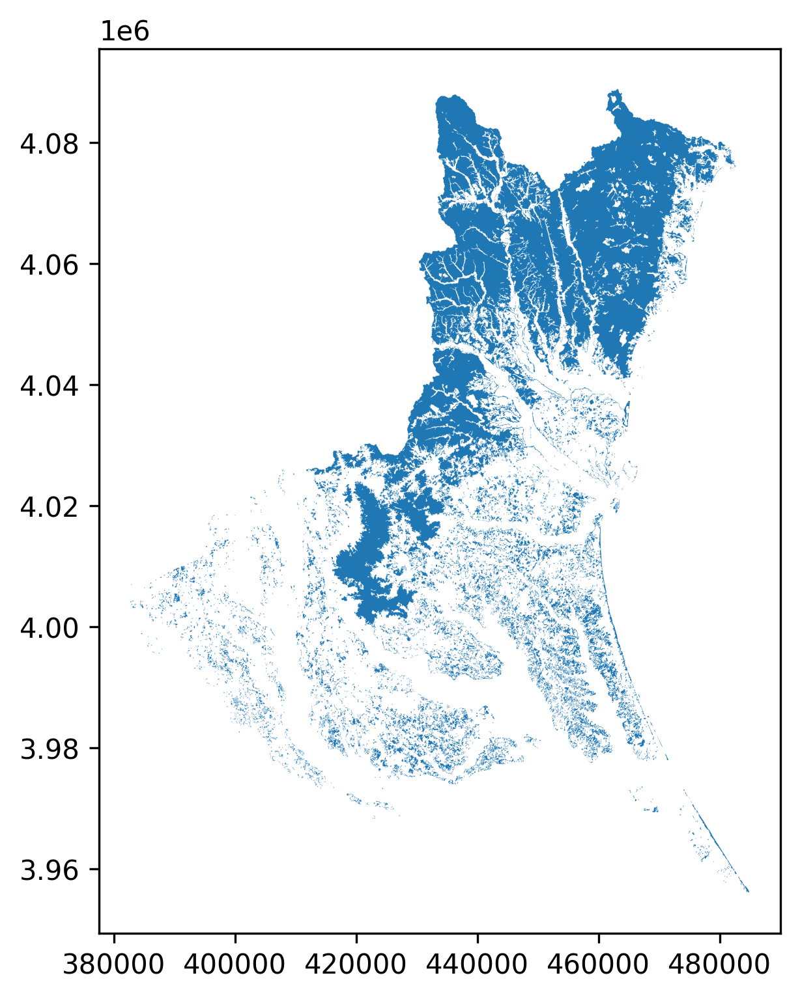

In [38]:
#森林マップポリゴン

#ダウンロードしたデータを解凍して、ディレクトリを指定
mori_shape_path = "/content/forestPolygon/"

# 森林マップポリゴンの読込(森林域のポリゴンは下2桁が07)
mori_shape = gpd.read_file(os.path.join(mori_shape_path + "a001080020160207.shp"),encoding="shift-jis")

#画像に合わせて投影変換
out_file_mori = os.path.join(mori_shape_path + "re_a001080020160207.shp")
re_mori_shape = mori_shape.to_crs({"init": "epsg:32654"})

#出力
re_mori_shape.to_file(driver="ESRI Shapefile",filename=out_file_mori)
print("done")

#GeoDataFrameを描画
f,ax = plt.subplots(1, figsize=(6,6))
ax = re_mori_shape.plot(axes=ax)
plt.show();

茨城県の森林地域のポリゴンです。青い部分が森林になります。

日立市内の森林のみを取得します。


In [ ]:
mergedGdf = gpd.overlay(re_shape,re_mori_shape,how='intersection')
out_Clippedfile = os.path.join(shape_path + "hitachiForest.shp")
mergedGdf.to_file(driver="ESRI Shapefile",filename=out_Clippedfile) #shpの出力

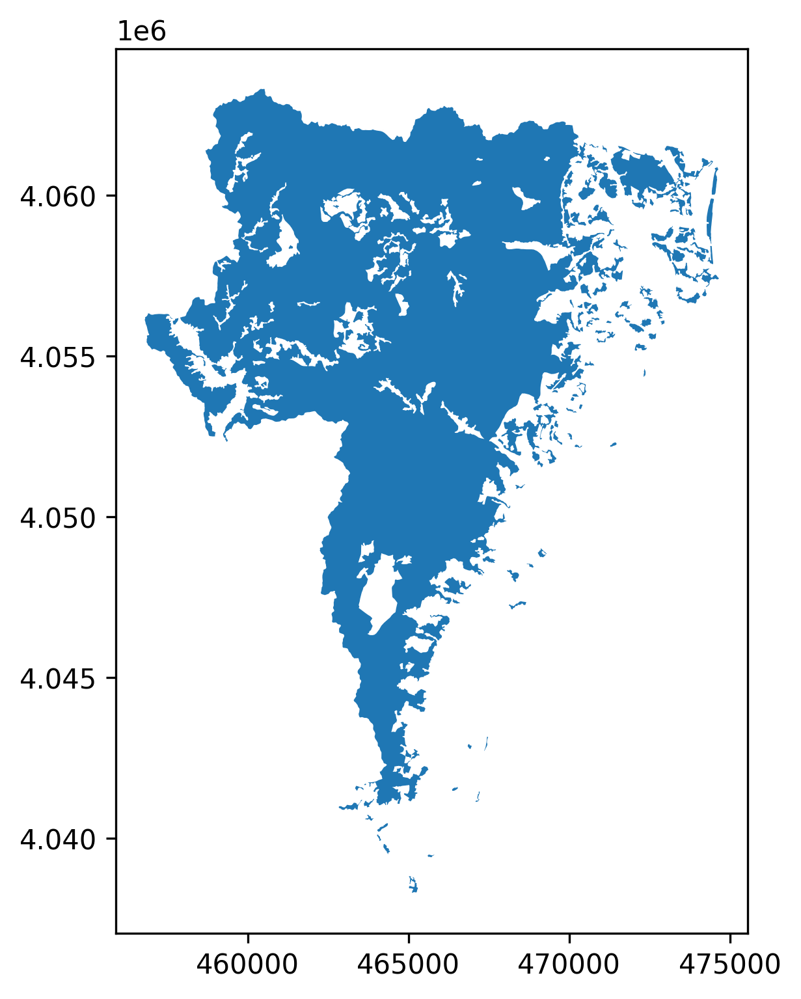

In [40]:
mergedGdf.plot(figsize = (6,6)) #描画

In [41]:
# 面積を求めるために参照系をJGD2011系に変換します
re_mergedGdf = mergedGdf.to_crs('epsg:6691')
re_mergedGdf['area_ha'] = re_mergedGdf.geometry.area/10**4
print(str(np.sum(re_mergedGdf['area_ha']))+' ha')

13515.086185906694 ha


ポリゴンデータから、日立市内には約14000ヘクタールの森林があることがわかります。

### 正規化植生指数（NDVI）

植生の活性度を見るためには、正規化植生指数（Normalized Difference Vegetation Index: NDVI）という指数を使うことが有効です。NDVIは、近赤外線（NIR）と赤色（Red）の波長帯のデータを使って、以下の計算式で求めることができます。

$ NDVI=(NIR-Red)/(NIR+Red)$

</br>

Sentinel-2の場合、バンド4で赤色、バンド8で近赤外線を使っているので、以下の式でNDVIを算出します。

$NDVI=(Band 8-Band 4)/(Band 8+Band 4)$

</br>

なお、NDVIについては[宙畑の記事](https://www.sorabatake.jp/5192/)でも紹介されているので参考にしてください。

日立市におけるNDVIを計算します。
Sentinel-2で雲の無いデータを取得できた4時期（4月、5月、10月、12月）全てでNDVIを計算します。

In [42]:
bandLists = ['B04','B08']
# 画像のURL取得
file_url = []
for item in selectItems:
  for band in bandLists:
    if file_url.append(item.assets[band].href) is not None:
      file_url.append(selectItems[0][band].href)

In [43]:
# NDVI画像を作成します。やや時間がかかります
for index, Id in enumerate(setIds):
  print("Start make a NDVI image " +'<'+ Id +'>')

  b4 = rio.open(file_url[index*2])
  red = b4.read()
  b8 = rio.open(file_url[index*2+1])
  nir = b8.read()
  print(file_url[index*2])
  print(file_url[index*2+1])
  ndvi = np.where(((red != 0) & (nir != 0)),(nir.astype(float)-red.astype(float))/(nir.astype(float)+red.astype(float)), 0)

  out_meta = b4.meta
  out_meta.update(driver='GTiff')
  out_meta.update(dtype=rio.float32)

  NDVI_path = os.path.join(NDVI_dir,'COGsentinel-2_'+Id+ '_ndvi.tif')

  with rio.open(NDVI_path, 'w', **out_meta) as dst:
    dst.write(ndvi.astype(rio.float32))

  print("---masking---")

  # 画像の切り取り処理
  with fiona.open(out_file, "r") as mask:
    masks = [feature["geometry"] for feature in mask] #ベクターデータが持つ図形情報の取得

  with rio.open(NDVI_path) as src:
    out_image, out_transform = rio.mask.mask(src, masks, crop=True) #mask処理の実行
    out_meta = src.meta #作成する画像の情報はもともとの画像と同様のものにします

  # メタ情報の更新
  out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

  # 画像の書き出し
  with rio.open(NDVI_path, "w", **out_meta) as dest:
    dest.write(out_image)
  
  print("Done")


Start make a NDVI image <S2A_54SVF_20170405_0_L2A>
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B08.tif
---masking---
Done
Start make a NDVI image <S2A_54SVF_20170508_0_L2A>
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B08.tif
---masking---
Done
Start make a NDVI image <S2B_54SVF_20171027_0_L2A>
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/10/S2B_54SVF_20171027_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/10/S2B_54SVF_20171027_0_L2A/B08.tif
---masking---
Done
Start make a NDVI image <S2B_54SVF_20171226_0_L2A>
https://sentinel-cogs.s3.us-w

In [ ]:
# Copernicus Open Access Hubからダウンロードしたファイルを利用する場合

# NDVI_dir = '/content/work/NDVI'

# for file_title in ziplis:
#   print("Start make NDVI " +'<'+ file_title +'>')

#   path_A = str(file_title) + '.SAFE/GRANULE/'
#   f1 = os.listdir(path_A)

#   path_B = str(file_title) + '.SAFE/GRANULE/' + str(f1[0])
#   f2 = os.listdir(path_B)

#   path_C = str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) + '/IMG_DATA/'
#   f3 = os.listdir(path_C)

#   b4 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B04.jp2'))
#   b8 = rio.open(str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) +'/IMG_DATA/' +str(f3[0][0:23] +'B08.jp2'))
  
#   red = b4.read()
#   nir = b8.read()
  
#   ndvi = np.where(((red != 0) & (nir != 0)),(nir.astype(float)-red.astype(float))/(nir.astype(float)+red.astype(float)), 0)

#   out_meta = b4.meta
#   out_meta.update(driver='GTiff')
#   out_meta.update(dtype=rasterio.float32)

#   NDVI_path = os.path.join(NDVI_dir,'sentinel-2_'+str(f3[0][7:15])+ '_ndvi.tif')

#   with rio.open(NDVI_path, 'w', **out_meta) as dst:
#     dst.write(ndvi.astype(rasterio.float32))

#   print("---masking---")

#   with fiona.open(out_file, "r") as mask:
#     masks = [feature["geometry"] for feature in mask]

#   with rio.open(NDVI_path) as src2:
#     out_image_ndvi, out_transform = rasterio.mask.mask(src2, masks, crop=True)
#     out_meta = src2.meta

#   out_meta.update({"driver": "GTiff",
#                  "height": out_image.shape[1],
#                  "width": out_image.shape[2],
#                  "transform": out_transform})

#   with rasterio.open(NDVI_path, "w", **out_meta) as dst2:
#     dst2.write(out_image_ndvi)

#   print("Done")

次に画像を表示します。

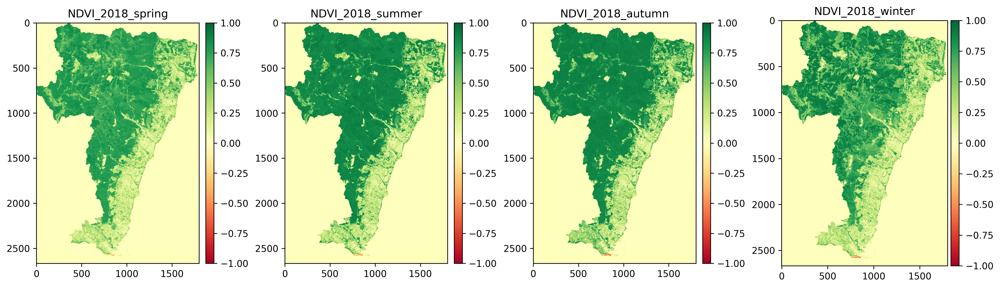

In [44]:
fig,(ax1,ax2,ax3,ax4)=plt.subplots(1,4, figsize=(18,9))
plt.subplots_adjust(wspace=0.4)

NDVI_2018_spring = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20180420_0_L2A_ndvi.tif')
NDVI_2018_summer = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20180520_0_L2A_ndvi.tif')
NDVI_2018_autumn = rio.open(NDVI_dir+'/COGsentinel-2_S2B_54SVF_20181002_0_L2A_ndvi.tif')
NDVI_2018_winter = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20181219_0_L2A_ndvi.tif')

NDVI_2018_spring = NDVI_2018_spring.read(1)
NDVI_2018_summer = NDVI_2018_summer.read(1)
NDVI_2018_autumn = NDVI_2018_autumn.read(1)
NDVI_2018_winter = NDVI_2018_winter.read(1)

ndvi1=ax1.imshow(NDVI_2018_spring, cmap='RdYlGn')
ax1.set_title("NDVI_2018_spring")
ndvi1.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax1)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi1, cax=ax_cb)

ndvi2=ax2.imshow(NDVI_2018_summer, cmap='RdYlGn')
ax2.set_title("NDVI_2018_summer")
ndvi2.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax2)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi2, cax=ax_cb)

ndvi3=ax3.imshow(NDVI_2018_autumn, cmap='RdYlGn')
ax3.set_title("NDVI_2018_autumn")
ndvi3.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax3)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi3, cax=ax_cb)

ndvi4=ax4.imshow(NDVI_2018_winter, cmap='RdYlGn')
ax4.set_title("NDVI_2018_winter")
ndvi4.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax4)
ax_cb = divider.new_horizontal(size="5%", pad=0.05)
fig.add_axes(ax_cb)
plt.colorbar(ndvi4, cax=ax_cb)

実際に作成したNDVIの画像を表示しました。画像左から順に、4月⇒5月⇒10月⇒12月のNDVI画像となっています。

これらの画像では画像同士の違いを比較しやすくするために、NDVIの範囲を-1から1に揃えています。

また、NDVIの値が1に近い（緑色が強い）ほど植物の活性が高いことを示しており、-1に近い（赤が強い）ほど植生が少ないことを示しています。

先ほどのカラー合成画像と見比べると、森林と思われる地域のNDVIはほとんど緑色になっていることがわかります。

### 森林地域のNDVIの計算

今回は森林を対象としているので、ポリゴンデータを使って不要な領域をマスク処理し、日立市の森林地域のみNDVIを計算してみましょう。

In [45]:
# NDVI画像を作成します。やや時間がかかります
for index, Id in enumerate(setIds):
  print("Start make a NDVI image " +'<'+ Id +'>')

  b4 = rio.open(file_url[index*2])
  red = b4.read()
  b8 = rio.open(file_url[index*2+1])
  nir = b8.read()
  print(file_url[index*2])
  print(file_url[index*2+1])
  np.seterr(divide='ignore', invalid='ignore') #0での割り算処理
  ndvi = (nir.astype(float) - red.astype(float)) / (nir + red)
  # ndvi = np.where(((red != 0) & (nir != 0)),(nir.astype(float)-red.astype(float))/(nir.astype(float)+red.astype(float)), 0)

  out_meta = b4.meta
  out_meta.update(driver='GTiff')
  out_meta.update(dtype=rio.float32)

  NDVI_path = os.path.join(NDVI_dir,'COGsentinel-2_'+Id+'_ndvi_mask.tif')

  with rio.open(NDVI_path, 'w', **out_meta) as dest:
    dest.write(ndvi.astype(rio.float32))

  print("---masking---")

  # 画像の切り取り処理

  with fiona.open(out_Clippedfile, "r") as mask_mori:
    masks_mori = [feature["geometry"] for feature in mask_mori]
    
  with rio.open(NDVI_path) as src:
    out_image_ndvi, out_transform = rio.mask.mask(src, masks_mori, crop=True)
    out_meta = src.meta
  out_meta.update({"driver": "GTiff","height": out_image_ndvi.shape[1],"width": out_image_ndvi.shape[2],"transform": out_transform})
  
  NDVI_mask_path = os.path.join(NDVI_mask_dir,'COGsentinel-2_'+Id+'forest_ndvi_mask.tif')

  with rio.open(NDVI_mask_path, "w", **out_meta) as dest:
    dest.write(out_image_ndvi)
  print("done")

Start make a NDVI image <S2A_54SVF_20170405_0_L2A>
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/4/S2A_54SVF_20170405_0_L2A/B08.tif
---masking---
done
Start make a NDVI image <S2A_54SVF_20170508_0_L2A>
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/5/S2A_54SVF_20170508_0_L2A/B08.tif
---masking---
done
Start make a NDVI image <S2B_54SVF_20171027_0_L2A>
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/10/S2B_54SVF_20171027_0_L2A/B04.tif
https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/54/S/VF/2017/10/S2B_54SVF_20171027_0_L2A/B08.tif
---masking---
done
Start make a NDVI image <S2B_54SVF_20171226_0_L2A>
https://sentinel-cogs.s3.us-w

In [321]:
# # Copernicus Open Access Hubでデータをダウンロードした場合
# NDVI_dir = '/content/work/NDVI'

# for file_title in ziplis:
#   print("Start masking NDVI " +'<'+ file_title +'>')
#   path_A = str(file_title) + '.SAFE/GRANULE/'
#   f1 = os.listdir(path_A)

#   path_B = str(file_title) + '.SAFE/GRANULE/' + str(f1[0])
#   f2 = os.listdir(path_B)
  
#   path_C = str(file_title) + '.SAFE/GRANULE/' + str(f1[0]) + '/IMG_DATA/'
#   f3 = os.listdir(path_C)

#   NDVI_path = os.path.join(NDVI_dir,'sentinel-2_'+str(f3[0][7:15])+ '_ndvi.tif')

#   with fiona.open(out_file_mori, "r") as mask_mori:
#     masks_mori = [feature["geometry"] for feature in mask_mori]
#   with rio.open(NDVI_path) as src3:
#     out_image_ndvi, out_transform = rasterio.mask.mask(src3, masks_mori, crop=True)
#     out_meta = src3.meta
#   out_meta.update({"driver": "GTiff","height": out_image_ndvi.shape[1],"width": out_image_ndvi.shape[2],"transform": out_transform})
  
#   NDVI_mask_path = os.path.join(NDVI_mask_dir,'sentinel-2_'+str(f3[0][7:15])+ '_ndvi_mask.tif')

#   with rasterio.open(NDVI_mask_path, "w", **out_meta) as dest3:
#     dest3.write(out_image_ndvi)
#   print("done")

次に画像を表示します。

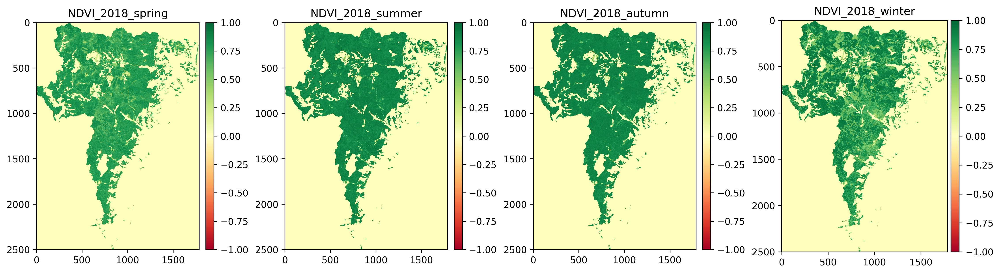

In [46]:
fig,(ax1,ax2,ax3,ax4)=plt.subplots(1,4, figsize=(18,9))
plt.subplots_adjust(wspace=0.4)

NDVI_2018_spring = rio.open(NDVI_mask_dir+'/COGsentinel-2_S2A_54SVF_20180420_0_L2Aforest_ndvi_mask.tif')
NDVI_2018_summer = rio.open(NDVI_mask_dir+'/COGsentinel-2_S2A_54SVF_20180520_0_L2Aforest_ndvi_mask.tif')
NDVI_2018_autumn = rio.open(NDVI_mask_dir+'/COGsentinel-2_S2B_54SVF_20181002_0_L2Aforest_ndvi_mask.tif')
NDVI_2018_winter = rio.open(NDVI_mask_dir+'/COGsentinel-2_S2A_54SVF_20181219_0_L2Aforest_ndvi_mask.tif')

NDVI_2018_spring = NDVI_2018_spring.read(1)
NDVI_2018_summer = NDVI_2018_summer.read(1)
NDVI_2018_autumn = NDVI_2018_autumn.read(1)
NDVI_2018_winter = NDVI_2018_winter.read(1)

ndvi1=ax1.imshow(NDVI_2018_spring, cmap='RdYlGn')
ax1.set_title("NDVI_2018_spring")
ndvi1.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax1)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi1, cax=ax_cb)

ndvi2=ax2.imshow(NDVI_2018_summer, cmap='RdYlGn')
ax2.set_title("NDVI_2018_summer")
ndvi2.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax2)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi2, cax=ax_cb)

ndvi3=ax3.imshow(NDVI_2018_autumn, cmap='RdYlGn')
ax3.set_title("NDVI_2018_autumn")
ndvi3.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax3)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi3, cax=ax_cb)

ndvi4=ax4.imshow(NDVI_2018_winter, cmap='RdYlGn')
ax4.set_title("NDVI_2018_winter")
ndvi4.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax4)
ax_cb = divider.new_horizontal(size="5%", pad=0.05)
fig.add_axes(ax_cb)
plt.colorbar(ndvi4, cax=ax_cb)

森林地域以外をマスクしたNDVIの画像を表示しました。画像左から順に、4月⇒5月⇒10月⇒12月のNDVI画像となっています。

先ほどと同様に、画像同士の違いを比較しやすくするために、NDVIの範囲を-1から1に揃えています。

マスク処理をすることにより、都市部など森林以外の地域が除外することができました。

### 森林状態変化のグラフ表示
作成したNDVI画像を用いて森林地域の変化を推定し、可視化します。
本章ではポリゴンによって抜き出した範囲を森林地域として、範囲内のNDVI変化をみることで、森林の状態変化を推定します。




はじめに森林地域のNDVI値を集計して平均値、最大値、最小値を算出します。

In [55]:
#NDVI値の集計
NDVI_list = os.listdir(NDVI_mask_dir)

NDVI_files = []
ind = []
col = []
NDVI_max=[]
NDVI_min=[]
value_ave=[]

#for scene in sorted(NDVI_list):
#  if "2018" in scene:
#    NDVI_files.append(scene)

for scene in sorted(NDVI_list):
   NDVI_files.append(scene)

for scene in sorted(NDVI_files):
  print("Start " +'<'+ scene +'>')
  NDVI_image = rio.open(NDVI_mask_dir +"/"+ scene)
  NDVI_image_2 = NDVI_image.read()
  ind.append(str(scene[24:32]))
  col.append('NDVI_' + str(scene[24:32]))
  NDVI_max.append(np.max(NDVI_image_2))
  NDVI_min.append(np.min(NDVI_image_2))
  NDVI_value = NDVI_image_2[np.nonzero(NDVI_image_2)].mean()
  print(NDVI_value)
  value_ave.append(NDVI_value)
  print("done")

Start <COGsentinel-2_S2A_54SVF_20170405_0_L2Aforest_ndvi_mask.tif>
0.6745473
done
Start <COGsentinel-2_S2A_54SVF_20170508_0_L2Aforest_ndvi_mask.tif>
0.81346804
done
Start <COGsentinel-2_S2A_54SVF_20180420_0_L2Aforest_ndvi_mask.tif>
0.7422276
done
Start <COGsentinel-2_S2A_54SVF_20180520_0_L2Aforest_ndvi_mask.tif>
0.8528053
done
Start <COGsentinel-2_S2A_54SVF_20181219_0_L2Aforest_ndvi_mask.tif>
0.7629077
done
Start <COGsentinel-2_S2B_54SVF_20171027_0_L2Aforest_ndvi_mask.tif>
0.80564314
done
Start <COGsentinel-2_S2B_54SVF_20171226_0_L2Aforest_ndvi_mask.tif>
0.75104475
done
Start <COGsentinel-2_S2B_54SVF_20181002_0_L2Aforest_ndvi_mask.tif>
0.86148393
done


※.ipynb_checkpointsがフォルダに含まれている場合には以下のコマンドで削除をしてください。

```
!rmdir folderpath/.ipynb_checkpoints
```



計算した結果を用いて、各時期のNDVI平均値を正規化します。7時期の中でNDVIの値が最も高いと考えられる5月のNDVI平均値を全体の最大値、最も数値の低いと考えられる12月のNDVI値を全体の最小値とします。


In [56]:
NDVI_normalized = []

for va in value_ave:
  nor = ((va - np.min(NDVI_min))/(np.max(NDVI_max) - np.min(NDVI_min)))
  NDVI_normalized.append(nor)
print("done")

done


正規化した値の中で、植生が最も活性化する夏季（本章では5月）の正規化NDVI平均値を基準に日立市における森林面積に対し、各季節と夏季の比率を積算することで、季節変化による森林の状態の変移を推定します。参照した国土数値情報および農林水産省のデータはいずれも2020年12月時点で最新版のものを使用しています。




In [57]:
print(NDVI_normalized)

[0.78565013, 0.87757707, 0.8304357, 0.9036075, 0.84412014, 0.8723992, 0.83627015, 0.90935034]


In [58]:
forest_area = np.sum(re_mergedGdf['area_ha'])

forest = []

for seasonal_data in NDVI_normalized:
  est_fore = forest_area * (seasonal_data/NDVI_normalized[1])
  forest.append(est_fore)

print("done")

done


In [59]:
forestDf = pd.DataFrame({'date': ind,
              'value': forest})
forestDf.sort_values('date',inplace=True)

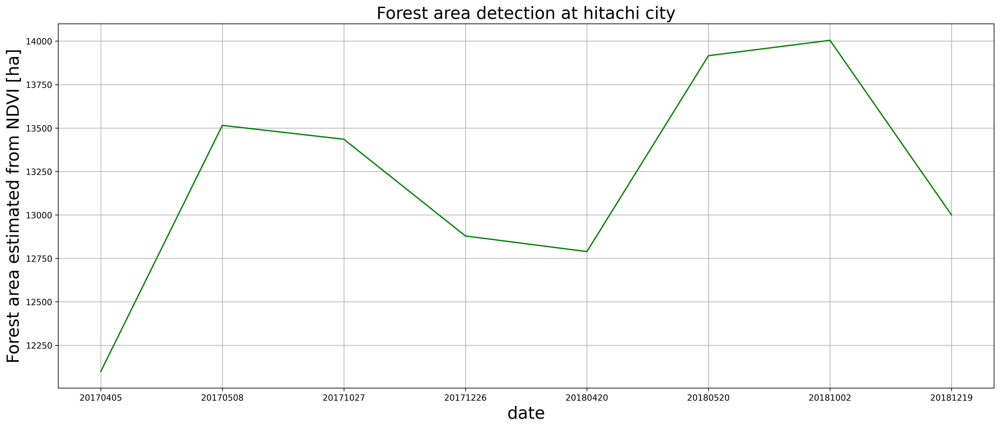

In [60]:
fig,ax1 = plt.subplots(1,1,figsize=(20,8))
ax1.plot(forestDf.date,forestDf.value,color="green")
ax1.set_xlabel("date",fontsize=20)
ax1.set_ylabel("Forest area estimated from NDVI [ha]",fontsize=20)
ax1.grid(True)
plt.title("Forest area detection at hitachi city",fontsize=20)
fig.show()

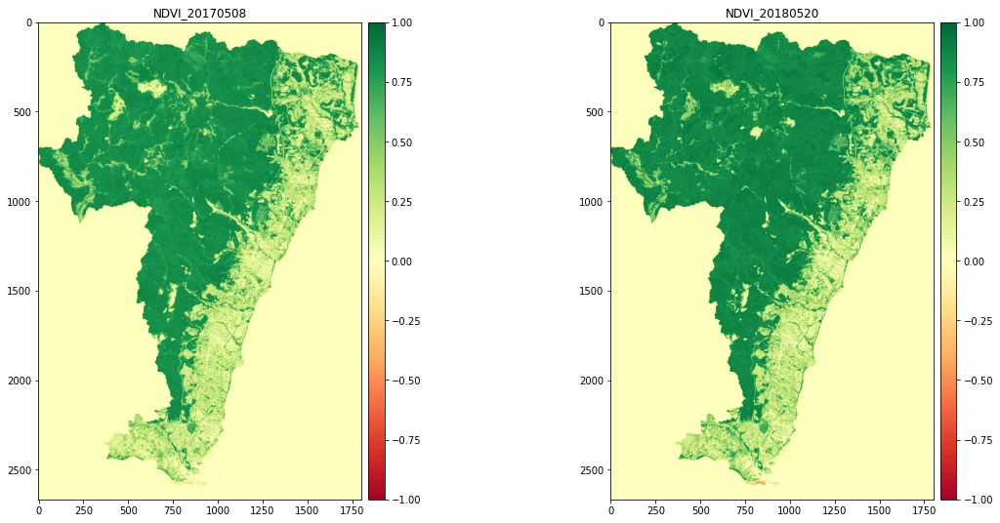

In [332]:
fig,(ax1,ax2)=plt.subplots(1,2, figsize=(18,9))
plt.subplots_adjust(wspace=0.4)

NDVI_2017 = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20170508_0_L2A_ndvi.tif')
NDVI_2018 = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20180520_0_L2A_ndvi.tif')


NDVI_2017 = NDVI_2017.read(1)
NDVI_2018 = NDVI_2018.read(1)

ndvi1=ax1.imshow(NDVI_2017, cmap='RdYlGn')
ax1.set_title("NDVI_20170508")
ndvi1.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax1)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi1, cax=ax_cb)

ndvi2=ax2.imshow(NDVI_2018, cmap='RdYlGn')
ax2.set_title("NDVI_20180520")
ndvi2.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax2)
ax_cb = divider.new_horizontal(size="5%", pad=0.1)
fig.add_axes(ax_cb)
plt.colorbar(ndvi2, cax=ax_cb)


また、画像の上側中央付近においてNDVIの数値が落ち込んでいる地点が見受けられます。

二時期のNDVIの差分を取り、切り出してみましょう。またカラー合成画像から同様の範囲を切り出して、NDVIの差分画像と比較してみましょう。

In [61]:
#範囲の指定
minX = 750
minY = 400
deltaX = 300
deltaY = 300

#NDVI差分の作成
NDVI_2017 = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20170508_0_L2A_ndvi.tif')
NDVI_2018 = rio.open(NDVI_dir+'/COGsentinel-2_S2A_54SVF_20180520_0_L2A_ndvi.tif')

ndvi_2017 = NDVI_2017.read()
ndvi_2018 = NDVI_2018.read()

ndvi_diff = np.where(((ndvi_2017 != 0) & (ndvi_2018 != 0)),(ndvi_2018.astype(float)-ndvi_2017.astype(float)), 0)

out_meta = NDVI_2017.meta
out_meta.update(driver='GTiff')
out_meta.update(dtype=rio.float32)

NDVI_diff_path = os.path.join(NDVI_dir,'sentinel-2_ndvi_diff.tif')

with rio.open(NDVI_diff_path, 'w', **out_meta) as dst:
  dst.write(ndvi_diff.astype(rio.float32))

path_ndvi_diff = "/content/work/NDVI/sentinel-2_ndvi_diff.tif"

#NDVI差分画像の切り出し
print("Start cliping images " +'<'+ str(path_ndvi_diff) +'>')
maskdata_path = os.path.join(NDVI_dir + "/" + "ndvi_diff_clip.tif")
ds=gdal.Translate(maskdata_path, path_ndvi_diff, srcWin=[minX,minY,deltaX,deltaY])

#RGB画像の指定
path_2017 = "/content/work/RGB_TIF/COGsentinel-2_S2A_54SVF_20170508_0_L2A.tif" 
path_2018 = "/content/work/RGB_TIF/COGsentinel-2_S2A_54SVF_20180520_0_L2A.tif" 

ln = [path_2017,path_2018]

#切り出し
for n in ln:
  print("Start cliping images " +'<'+ n +'>')
  maskdata_path = os.path.join(RGB_dir + "/" + "clip_" + str(n[46:50]) + ".tif")
  ds=gdal.Translate(maskdata_path, n, srcWin=[minX,minY,deltaX,deltaY])
  ds=None

Start cliping images </content/work/NDVI/sentinel-2_ndvi_diff.tif>
Start cliping images </content/work/RGB_TIF/COGsentinel-2_S2A_54SVF_20170508_0_L2A.tif>
Start cliping images </content/work/RGB_TIF/COGsentinel-2_S2A_54SVF_20180520_0_L2A.tif>


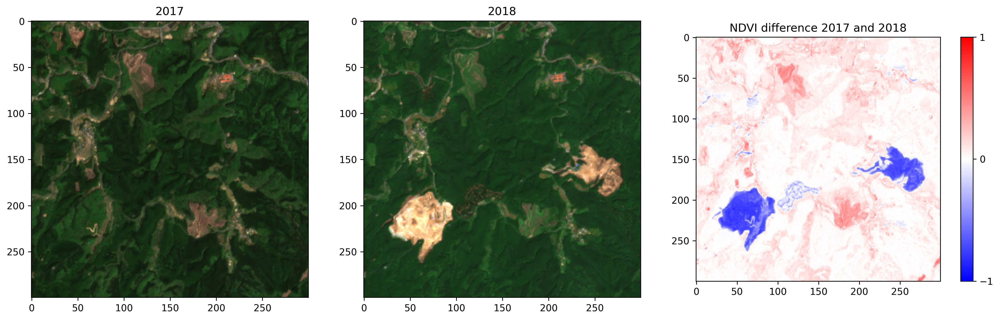

In [62]:
fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(18,18))

#画像の読み込み
cut_img2017=rio.open("/content/work/RGB_TIF/clip_2017.tif")
cut_img2018=rio.open("/content/work/RGB_TIF/clip_2018.tif")
cut_imgNDVI=rio.open("/content/work/NDVI/ndvi_diff_clip.tif")

ax1 = plt.subplot(1,3,1)
ax1.set_title("2017")
ax2 = plt.subplot(1,3,2)
ax2.set_title("2018")
ax3 = plt.subplot(1,3,3)
ax3.set_title("NDVI difference 2017 and 2018")

show(cut_img2017.read([1,2,3]),ax=ax1)
show(cut_img2018.read([1,2,3]),ax=ax2)

img_n = ax3.imshow(cut_imgNDVI.read(1), cmap=plt.cm.bwr)
img_n.set_clim(vmin=-1, vmax=1)
divider = make_axes_locatable(ax3)
cax = divider.append_axes("right",size="5%", pad=0.3)
cbar = plt.colorbar(img_n, cax=cax,ticks=[-1, 0, 1])

上の図は左から、2017年のカラー合成画像、2018年のカラー合成画像、2017年と2018年のNDVIの差分画像となっています。NDVI差分画像の範囲は-1から1をとっており、差分の値が1に近い（赤色が強い）ほど植物が増えていることを示しており、-1に近い（青色が強い）ほど植生が減少していることを示しています。

差分画像とカラー合成画像を見比べてみると、青色が強調されている地域では、森林と思われる地域が裸地に変化しているようです。
赤色が強調されている地域は、もともと裸地であった地域に植生が繁茂しているようです。これは落葉樹の展葉等に伴い、一時的に変化として表れていることが考えられます。
そのため、経年変化で比較する際にも、取得する衛星の観測時期を考慮する必要があるといえます。



青色が強調されている地域の様子をGoogle Earthで見てみると、2020年3月時点でソーラーパネルによる発電施設が建設されていることがわかりました。

以上のことから、同じ年の複数時期の衛星データを比較することによって森林の状態変化を、別の年のデータを比較することで森林の増加や減少を確認することができました。NDVIの差分画像を使えば、広い範囲でも森林の伐採箇所を見つけやすくなります。

森林のNDVIは樹種によって季節で変化するため、衛星で森林の減少を監視するためには、適切な時期の衛星データを使うことが重要です。
